In [1]:
#import requests
from bs4 import BeautifulSoup
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import statsmodels.api as sm
from statsmodels.formula.api import ols
import statsmodels
from scipy import stats

In [2]:
realestate_df= pd.read_csv('data/real_estate.csv')
realestate_df

,type,zipcode,city,state,metro,county,size_rank,1996-04,1996-05,1996-06,...,2016-09,2016-10,2016-11,2016-12,2017-01,2017-02,2017-03,2017-04,2017-05,2017-06
0,ZHVI,10025,New York,NY,New York,New York,1,NaN,NaN,NaN,...,1137500,1137700,1152700,1156000.0,1140200,1130000,1131900,1149600,1198400,1247000
1,ZHVI,60657,Chicago,IL,Chicago,Cook,2,146700.0,146500.0,146300.0,...,318200,318100,318800,320200.0,320800,322000,323800,326100,327800,329100
2,ZHVI,60614,Chicago,IL,Chicago,Cook,3,198000.0,195500.0,194200.0,...,401900,406000,414100,417800.0,417400,418400,414100,404100,406400,415500
3,ZHVI,79936,El Paso,TX,El Paso,El Paso,4,70800.0,71000.0,71000.0,...,113800,113900,114100,114500.0,114900,115000,114700,114700,114800,114700
4,ZHVI,60640,Chicago,IL,Chicago,Cook,5,102300.0,101300.0,100700.0,...,198800,199200,200100,201500.0,203000,205100,206700,206500,206200,206700
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29106,ZRI,12720,Bethel,NY,NaN,Sullivan,15907,NaN,NaN,NaN,...,1185,1181,1174,1167.0,1156,1162,1175,1194,1202,1206
29107,ZRI,1338,Shelburne Falls,MA,Greenfield Town,Franklin,15908,NaN,NaN,NaN,...,1769,1772,1775,1780.0,1786,1790,1797,1798,1796,1795
29108,ZRI,21405,Annapolis,MD,Baltimore,Anne Arundel,15909,NaN,NaN,NaN,...,4048,4005,3888,3729.0,3563,3493,3474,3496,3488,3471
29109,ZRI,85220,Apache Junction,AZ,Phoenix,Pinal,15910,NaN,NaN,NaN,...,1007,1018,1035,1052.0,1061,1060,1058,1065,1074,1080


In [3]:
realestate_df['type'].value_counts()

ZRI     15911
ZHVI    13200
Name: type, dtype: int64

## Realestate Shape

In [4]:
print ('Real Estate shape: ', realestate_df.shape)

Real Estate shape:  (29111, 262)


## Real Estate Columns Name

In [5]:
print('Real Estate Column Names: ', realestate_df.columns.values)

Real Estate Column Names:  ['type' 'zipcode' 'city' 'state' 'metro' 'county' 'size_rank' '1996-04'
 '1996-05' '1996-06' '1996-07' '1996-08' '1996-09' '1996-10' '1996-11'
 '1996-12' '1997-01' '1997-02' '1997-03' '1997-04' '1997-05' '1997-06'
 '1997-07' '1997-08' '1997-09' '1997-10' '1997-11' '1997-12' '1998-01'
 '1998-02' '1998-03' '1998-04' '1998-05' '1998-06' '1998-07' '1998-08'
 '1998-09' '1998-10' '1998-11' '1998-12' '1999-01' '1999-02' '1999-03'
 '1999-04' '1999-05' '1999-06' '1999-07' '1999-08' '1999-09' '1999-10'
 '1999-11' '1999-12' '2000-01' '2000-02' '2000-03' '2000-04' '2000-05'
 '2000-06' '2000-07' '2000-08' '2000-09' '2000-10' '2000-11' '2000-12'
 '2001-01' '2001-02' '2001-03' '2001-04' '2001-05' '2001-06' '2001-07'
 '2001-08' '2001-09' '2001-10' '2001-11' '2001-12' '2002-01' '2002-02'
 '2002-03' '2002-04' '2002-05' '2002-06' '2002-07' '2002-08' '2002-09'
 '2002-10' '2002-11' '2002-12' '2003-01' '2003-02' '2003-03' '2003-04'
 '2003-05' '2003-06' '2003-07' '2003-08' '2003-09

## Handling Missing Data

In [6]:
print('null values: \n',)
print(realestate_df.isna().sum(), '\n')
print('Total null values: ' ,realestate_df.isna().sum().sum())

null values: 

type          0
zipcode       0
city          0
state         0
metro      1865
           ... 
2017-02       0
2017-03       0
2017-04       0
2017-05       0
2017-06       0
Length: 262, dtype: int64 

Total null values:  3144405


## Duplicate Data in a Data-Frame:

In [7]:
duplicated_rows_df= realestate_df[realestate_df.duplicated()]
print('number of duplicate rows: ', duplicated_rows_df.shape)

number of duplicate rows:  (0, 262)


## FIll Nan Rows with Average values

In [8]:
yeardf= realestate_df.iloc[:, 136:]
m = yeardf.mean(axis=1)
for i, col in enumerate(yeardf):
    yeardf.iloc[:, i] = yeardf.iloc[:, i].fillna(m)
yeardf

,2007-01,2007-02,2007-03,2007-04,2007-05,2007-06,2007-07,2007-08,2007-09,2007-10,...,2016-09,2016-10,2016-11,2016-12,2017-01,2017-02,2017-03,2017-04,2017-05,2017-06
0,774500.0000,767600.0000,759000.0000,744200.0000,729900.0000,721300.0000,726900.0000,743600.0000,757300.0000,759600.0000,...,1137500,1137700,1152700,1156000.0,1140200,1130000,1131900,1149600,1198400,1247000
1,318000.0000,318600.0000,319200.0000,319400.0000,320700.0000,321500.0000,322400.0000,324000.0000,324500.0000,323800.0000,...,318200,318100,318800,320200.0,320800,322000,323800,326100,327800,329100
2,386400.0000,386300.0000,387700.0000,389200.0000,390600.0000,392300.0000,395800.0000,397900.0000,398200.0000,398200.0000,...,401900,406000,414100,417800.0,417400,418400,414100,404100,406400,415500
3,127000.0000,128000.0000,128300.0000,128500.0000,129000.0000,130000.0000,130800.0000,131000.0000,130700.0000,130600.0000,...,113800,113900,114100,114500.0,114900,115000,114700,114700,114800,114700
4,237000.0000,237800.0000,237600.0000,237400.0000,237700.0000,237400.0000,236100.0000,235100.0000,234400.0000,233800.0000,...,198800,199200,200100,201500.0,203000,205100,206700,206500,206200,206700
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29106,1165.7250,1165.7250,1165.7250,1165.7250,1165.7250,1165.7250,1165.7250,1165.7250,1165.7250,1165.7250,...,1185,1181,1174,1167.0,1156,1162,1175,1194,1202,1206
29107,1613.8375,1613.8375,1613.8375,1613.8375,1613.8375,1613.8375,1613.8375,1613.8375,1613.8375,1613.8375,...,1769,1772,1775,1780.0,1786,1790,1797,1798,1796,1795
29108,3551.8625,3551.8625,3551.8625,3551.8625,3551.8625,3551.8625,3551.8625,3551.8625,3551.8625,3551.8625,...,4048,4005,3888,3729.0,3563,3493,3474,3496,3488,3471
29109,917.5625,917.5625,917.5625,917.5625,917.5625,917.5625,917.5625,917.5625,917.5625,917.5625,...,1007,1018,1035,1052.0,1061,1060,1058,1065,1074,1080


In [9]:
realecateg=realestate_df.iloc[:, :7]
realecateg

,type,zipcode,city,state,metro,county,size_rank
0,ZHVI,10025,New York,NY,New York,New York,1
1,ZHVI,60657,Chicago,IL,Chicago,Cook,2
2,ZHVI,60614,Chicago,IL,Chicago,Cook,3
3,ZHVI,79936,El Paso,TX,El Paso,El Paso,4
4,ZHVI,60640,Chicago,IL,Chicago,Cook,5
...,...,...,...,...,...,...,...
29106,ZRI,12720,Bethel,NY,NaN,Sullivan,15907
29107,ZRI,1338,Shelburne Falls,MA,Greenfield Town,Franklin,15908
29108,ZRI,21405,Annapolis,MD,Baltimore,Anne Arundel,15909
29109,ZRI,85220,Apache Junction,AZ,Phoenix,Pinal,15910


In [10]:
realestate_df= pd.concat([realecateg, yeardf], axis=1)
realestate_df

,type,zipcode,city,state,metro,county,size_rank,2007-01,2007-02,2007-03,...,2016-09,2016-10,2016-11,2016-12,2017-01,2017-02,2017-03,2017-04,2017-05,2017-06
0,ZHVI,10025,New York,NY,New York,New York,1,774500.0000,767600.0000,759000.0000,...,1137500,1137700,1152700,1156000.0,1140200,1130000,1131900,1149600,1198400,1247000
1,ZHVI,60657,Chicago,IL,Chicago,Cook,2,318000.0000,318600.0000,319200.0000,...,318200,318100,318800,320200.0,320800,322000,323800,326100,327800,329100
2,ZHVI,60614,Chicago,IL,Chicago,Cook,3,386400.0000,386300.0000,387700.0000,...,401900,406000,414100,417800.0,417400,418400,414100,404100,406400,415500
3,ZHVI,79936,El Paso,TX,El Paso,El Paso,4,127000.0000,128000.0000,128300.0000,...,113800,113900,114100,114500.0,114900,115000,114700,114700,114800,114700
4,ZHVI,60640,Chicago,IL,Chicago,Cook,5,237000.0000,237800.0000,237600.0000,...,198800,199200,200100,201500.0,203000,205100,206700,206500,206200,206700
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29106,ZRI,12720,Bethel,NY,NaN,Sullivan,15907,1165.7250,1165.7250,1165.7250,...,1185,1181,1174,1167.0,1156,1162,1175,1194,1202,1206
29107,ZRI,1338,Shelburne Falls,MA,Greenfield Town,Franklin,15908,1613.8375,1613.8375,1613.8375,...,1769,1772,1775,1780.0,1786,1790,1797,1798,1796,1795
29108,ZRI,21405,Annapolis,MD,Baltimore,Anne Arundel,15909,3551.8625,3551.8625,3551.8625,...,4048,4005,3888,3729.0,3563,3493,3474,3496,3488,3471
29109,ZRI,85220,Apache Junction,AZ,Phoenix,Pinal,15910,917.5625,917.5625,917.5625,...,1007,1018,1035,1052.0,1061,1060,1058,1065,1074,1080


## Fill NA Metro

In [11]:
realestate_df.metro.fillna("Empty", inplace=True)
#realestate_df

In [12]:
realestate_df.isna().sum().sum()

0

##  Melting date 2007 -2017 columns on a single column in Data-Set:

In [13]:
yeardf= yeardf.columns.tolist() # Listado de años y meses de la df realstate
#yearlist
realestate_df = pd.melt(realestate_df, id_vars=['type','zipcode','city','state','metro','county','size_rank'], value_vars= yeardf , var_name='date', value_name= 'Value')
realestate_df

,type,zipcode,city,state,metro,county,size_rank,date,Value
0,ZHVI,10025,New York,NY,New York,New York,1,2007-01,774500.0
1,ZHVI,60657,Chicago,IL,Chicago,Cook,2,2007-01,318000.0
2,ZHVI,60614,Chicago,IL,Chicago,Cook,3,2007-01,386400.0
3,ZHVI,79936,El Paso,TX,El Paso,El Paso,4,2007-01,127000.0
4,ZHVI,60640,Chicago,IL,Chicago,Cook,5,2007-01,237000.0
...,...,...,...,...,...,...,...,...,...
3667981,ZRI,12720,Bethel,NY,Empty,Sullivan,15907,2017-06,1206.0
3667982,ZRI,1338,Shelburne Falls,MA,Greenfield Town,Franklin,15908,2017-06,1795.0
3667983,ZRI,21405,Annapolis,MD,Baltimore,Anne Arundel,15909,2017-06,3471.0
3667984,ZRI,85220,Apache Junction,AZ,Phoenix,Pinal,15910,2017-06,1080.0


## Drop NA values

In [14]:
realestate_df = realestate_df.dropna()
print('new dataframe shape: ', realestate_df.shape)
realestate_df

new dataframe shape:  (3667986, 9)


,type,zipcode,city,state,metro,county,size_rank,date,Value
0,ZHVI,10025,New York,NY,New York,New York,1,2007-01,774500.0
1,ZHVI,60657,Chicago,IL,Chicago,Cook,2,2007-01,318000.0
2,ZHVI,60614,Chicago,IL,Chicago,Cook,3,2007-01,386400.0
3,ZHVI,79936,El Paso,TX,El Paso,El Paso,4,2007-01,127000.0
4,ZHVI,60640,Chicago,IL,Chicago,Cook,5,2007-01,237000.0
...,...,...,...,...,...,...,...,...,...
3667981,ZRI,12720,Bethel,NY,Empty,Sullivan,15907,2017-06,1206.0
3667982,ZRI,1338,Shelburne Falls,MA,Greenfield Town,Franklin,15908,2017-06,1795.0
3667983,ZRI,21405,Annapolis,MD,Baltimore,Anne Arundel,15909,2017-06,3471.0
3667984,ZRI,85220,Apache Junction,AZ,Phoenix,Pinal,15910,2017-06,1080.0


The relevant features we will use in this case are:

1. **zipcode:** code to identify the real estate
2. **city:** name of the city where is located the real estate
3. **state:** name of the state where is located the real estate
4. **county:** name of the county where is located the real estate
5. **date:** date reference for the real estate value 
6. **value:** value of the real estate in a specific date"

## Detecting Outliers in a Data-Set:

##  Change Date column to datetime

In [15]:
realestate_df['date'] = pd.to_datetime(realestate_df['date'], format='%Y-%m')
#realstate.info()

## Creating month and year columns

In [16]:
realestate_df['year'] = pd.DatetimeIndex(realestate_df['date']).year
realestate_df['month'] = pd.DatetimeIndex(realestate_df['date']).month
realestate_df

,type,zipcode,city,state,metro,county,size_rank,date,Value,year,month
0,ZHVI,10025,New York,NY,New York,New York,1,2007-01-01,774500.0,2007,1
1,ZHVI,60657,Chicago,IL,Chicago,Cook,2,2007-01-01,318000.0,2007,1
2,ZHVI,60614,Chicago,IL,Chicago,Cook,3,2007-01-01,386400.0,2007,1
3,ZHVI,79936,El Paso,TX,El Paso,El Paso,4,2007-01-01,127000.0,2007,1
4,ZHVI,60640,Chicago,IL,Chicago,Cook,5,2007-01-01,237000.0,2007,1
...,...,...,...,...,...,...,...,...,...,...,...
3667981,ZRI,12720,Bethel,NY,Empty,Sullivan,15907,2017-06-01,1206.0,2017,6
3667982,ZRI,1338,Shelburne Falls,MA,Greenfield Town,Franklin,15908,2017-06-01,1795.0,2017,6
3667983,ZRI,21405,Annapolis,MD,Baltimore,Anne Arundel,15909,2017-06-01,3471.0,2017,6
3667984,ZRI,85220,Apache Junction,AZ,Phoenix,Pinal,15910,2017-06-01,1080.0,2017,6


## Fill zipcode with 0

In [17]:
realestate_df['zipcode']=realestate_df['zipcode'].astype(str)
realestate_df['zipcode_clean'] =realestate_df['zipcode'].apply(lambda x: x.zfill(5))
realestate_df

,type,zipcode,city,state,metro,county,size_rank,date,Value,year,month,zipcode_clean
0,ZHVI,10025,New York,NY,New York,New York,1,2007-01-01,774500.0,2007,1,10025
1,ZHVI,60657,Chicago,IL,Chicago,Cook,2,2007-01-01,318000.0,2007,1,60657
2,ZHVI,60614,Chicago,IL,Chicago,Cook,3,2007-01-01,386400.0,2007,1,60614
3,ZHVI,79936,El Paso,TX,El Paso,El Paso,4,2007-01-01,127000.0,2007,1,79936
4,ZHVI,60640,Chicago,IL,Chicago,Cook,5,2007-01-01,237000.0,2007,1,60640
...,...,...,...,...,...,...,...,...,...,...,...,...
3667981,ZRI,12720,Bethel,NY,Empty,Sullivan,15907,2017-06-01,1206.0,2017,6,12720
3667982,ZRI,1338,Shelburne Falls,MA,Greenfield Town,Franklin,15908,2017-06-01,1795.0,2017,6,01338
3667983,ZRI,21405,Annapolis,MD,Baltimore,Anne Arundel,15909,2017-06-01,3471.0,2017,6,21405
3667984,ZRI,85220,Apache Junction,AZ,Phoenix,Pinal,15910,2017-06-01,1080.0,2017,6,85220


## Creating ZHVI and ZRI dataframe

In [18]:
rszhvi= realestate_df[ realestate_df['type'].isin(['ZHVI'])]
rszhvi


,type,zipcode,city,state,metro,county,size_rank,date,Value,year,month,zipcode_clean
0,ZHVI,10025,New York,NY,New York,New York,1,2007-01-01,774500.0,2007,1,10025
1,ZHVI,60657,Chicago,IL,Chicago,Cook,2,2007-01-01,318000.0,2007,1,60657
2,ZHVI,60614,Chicago,IL,Chicago,Cook,3,2007-01-01,386400.0,2007,1,60614
3,ZHVI,79936,El Paso,TX,El Paso,El Paso,4,2007-01-01,127000.0,2007,1,79936
4,ZHVI,60640,Chicago,IL,Chicago,Cook,5,2007-01-01,237000.0,2007,1,60640
...,...,...,...,...,...,...,...,...,...,...,...,...
3652070,ZHVI,97102,Arch Cape,OR,Astoria,Clatsop,13196,2017-06-01,602000.0,2017,6,97102
3652071,ZHVI,36564,Fairhope,AL,Daphne,Baldwin,13197,2017-06-01,551100.0,2017,6,36564
3652072,ZHVI,3293,Woodstock,NH,Claremont,Grafton,13198,2017-06-01,171300.0,2017,6,03293
3652073,ZHVI,21405,Annapolis,MD,Baltimore,Anne Arundel,13199,2017-06-01,785500.0,2017,6,21405


In [19]:
rszri= realestate_df[ realestate_df['type'].isin(['ZHVI'])]
#rszri

In [20]:
rszhvi[rszhvi['zipcode']== '21405']

,type,zipcode,city,state,metro,county,size_rank,date,Value,year,month,zipcode_clean
13198,ZHVI,21405,Annapolis,MD,Baltimore,Anne Arundel,13199,2007-01-01,831300.0,2007,1,21405
42309,ZHVI,21405,Annapolis,MD,Baltimore,Anne Arundel,13199,2007-02-01,832800.0,2007,2,21405
71420,ZHVI,21405,Annapolis,MD,Baltimore,Anne Arundel,13199,2007-03-01,836500.0,2007,3,21405
100531,ZHVI,21405,Annapolis,MD,Baltimore,Anne Arundel,13199,2007-04-01,837700.0,2007,4,21405
129642,ZHVI,21405,Annapolis,MD,Baltimore,Anne Arundel,13199,2007-05-01,840400.0,2007,5,21405
...,...,...,...,...,...,...,...,...,...,...,...,...
3535629,ZHVI,21405,Annapolis,MD,Baltimore,Anne Arundel,13199,2017-02-01,773600.0,2017,2,21405
3564740,ZHVI,21405,Annapolis,MD,Baltimore,Anne Arundel,13199,2017-03-01,765300.0,2017,3,21405
3593851,ZHVI,21405,Annapolis,MD,Baltimore,Anne Arundel,13199,2017-04-01,767200.0,2017,4,21405
3622962,ZHVI,21405,Annapolis,MD,Baltimore,Anne Arundel,13199,2017-05-01,775900.0,2017,5,21405


## Histogram RS

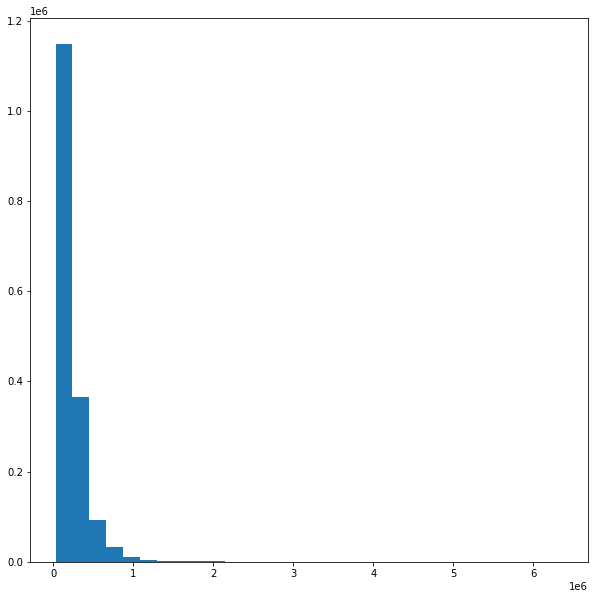

In [21]:
plt.figure(figsize=(10, 10))
plt.hist(rszhvi['Value'],bins = 30 )
None

## Real Estate df unique count

In [22]:
for col in realestate_df:
    uni=len(rszhvi[col].unique())
    print('Count of unique values of',col, ':', uni)

Count of unique values of type : 1
Count of unique values of zipcode : 13200
Count of unique values of city : 6975
Count of unique values of state : 49
Count of unique values of metro : 579
Count of unique values of county : 937
Count of unique values of size_rank : 13200
Count of unique values of date : 126
Count of unique values of Value : 19664
Count of unique values of year : 11
Count of unique values of month : 12
Count of unique values of zipcode_clean : 13200


## Counts per State Plot

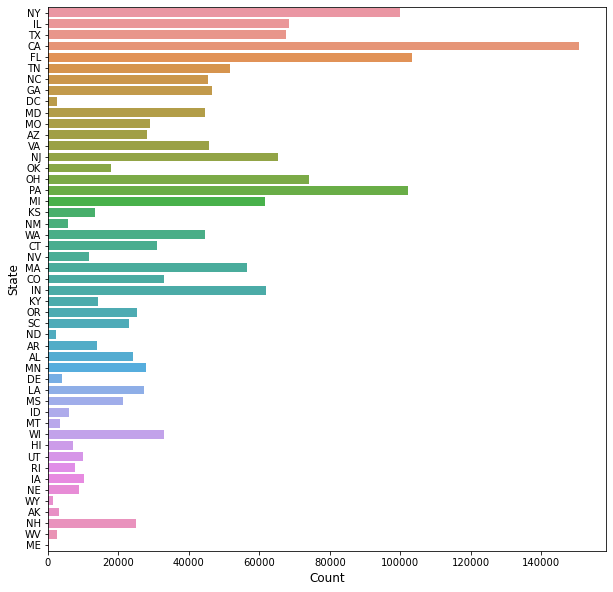

In [23]:
plt.figure(figsize=(10, 10))
sns.countplot(y='state', data= rszhvi )
plt.xlabel('Count', fontsize=12)
plt.ylabel('State', fontsize=12)
plt.show()  

## Count of citys and countys

In [24]:
cityc = rszhvi.groupby(['city']).size().sort_values(ascending=False)[:]
print(cityc, '\n') 
  
countyc = rszhvi.groupby(['county']).size().sort_values(ascending=False)[:]
print(countyc)

city
New York        13986
Los Angeles     12222
Chicago          6678
Philadelphia     5670
Phoenix          5040
                ...  
Talbott           126
Manvel            126
Takoma Park       126
Maple Falls       126
Zumbro Falls      126
Length: 6975, dtype: int64 

county
Los Angeles    33138
Washington     21924
Orange         21168
Jefferson      19908
Cook           19530
               ...  
Moffat           126
Monongalia       126
Catahoula        126
Montague         126
Zavala           126
Length: 937, dtype: int64


## Relationships Between Value ans Size Rank Real Estate

In [25]:
#sns.jointplot(x=rszhvi['Value'], y=rszhvi['size_rank']);

## Average Value per State

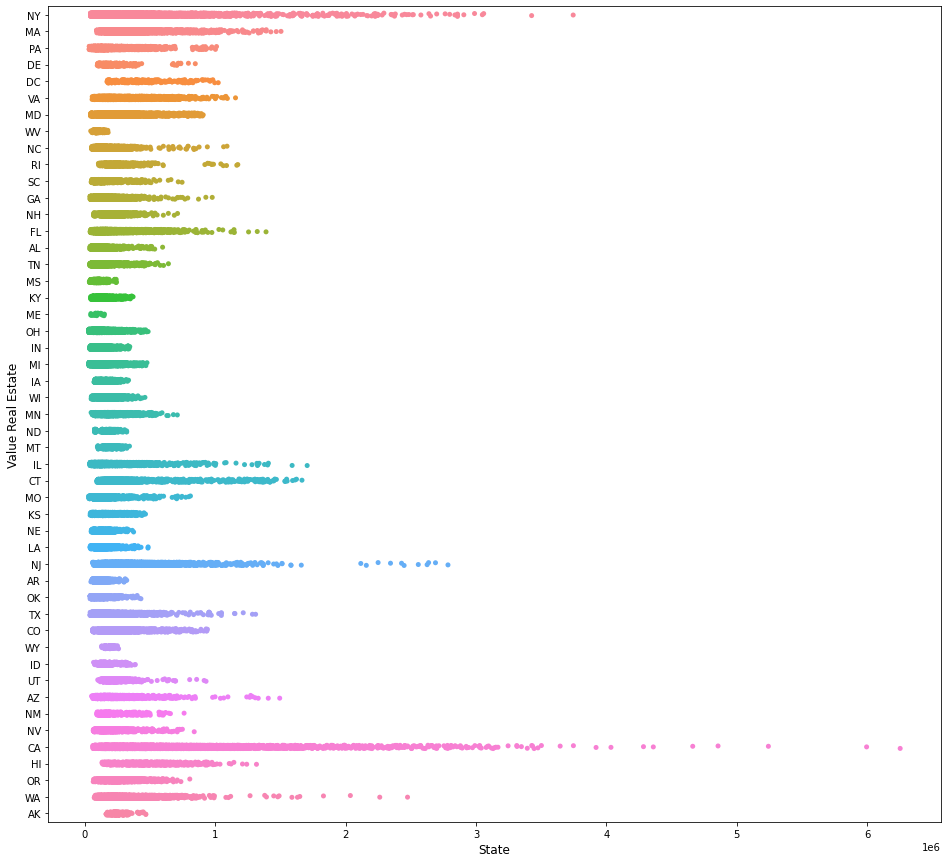

In [26]:
realestate_out = rszhvi.groupby(['zipcode','year','state','city','county'])['Value'].mean().reset_index()
    
plt.figure(figsize=(16, 15))
sns.stripplot(x="Value", y="state", data=realestate_out, size= 5 )
plt.xlabel('State', fontsize=12)
plt.ylabel('Value Real Estate', fontsize=12)
plt.show()

## Check the real estate with the maximum mean value over the years

In [27]:
realestate_out[['city','state','Value']].iloc[realestate_out['Value'].idxmax()]

city        Atherton
state             CA
Value    6.25295e+06
Name: 133121, dtype: object

## Basic statistical details of Real Estate values over the States

In [28]:
realestate_out['Value'].describe()

count    1.452000e+05
mean     2.297079e+05
std      2.078295e+05
min      2.712500e+04
25%      1.165146e+05
50%      1.690083e+05
75%      2.710771e+05
max      6.252950e+06
Name: Value, dtype: float64

In [29]:
realestate_out['state'].nunique()

49

## Data Type columns

In [30]:
print('data types: \n', realestate_df.dtypes)

data types: 
 type                     object
zipcode                  object
city                     object
state                    object
metro                    object
county                   object
size_rank                 int64
date             datetime64[ns]
Value                   float64
year                      int64
month                     int64
zipcode_clean            object
dtype: object


## Year Real Estate Values Trends

# Agrupacion por zipcode , year , state, Valor promedio

In [31]:
realestate_df2 = rszhvi.groupby(['type','zipcode', 'year','state','city'])['Value'].mean().reset_index()
realestate_df2

,type,zipcode,year,state,city,Value
0,ZHVI,10004,2007,NY,New York,1.018650e+06
1,ZHVI,10004,2008,NY,New York,1.089225e+06
2,ZHVI,10004,2009,NY,New York,1.120400e+06
3,ZHVI,10004,2010,NY,New York,1.004900e+06
4,ZHVI,10004,2011,NY,New York,9.889667e+05
...,...,...,...,...,...,...
145195,ZHVI,99901,2013,AK,Ketchikan,2.229333e+05
145196,ZHVI,99901,2014,AK,Ketchikan,2.228750e+05
145197,ZHVI,99901,2015,AK,Ketchikan,2.224083e+05
145198,ZHVI,99901,2016,AK,Ketchikan,2.252083e+05


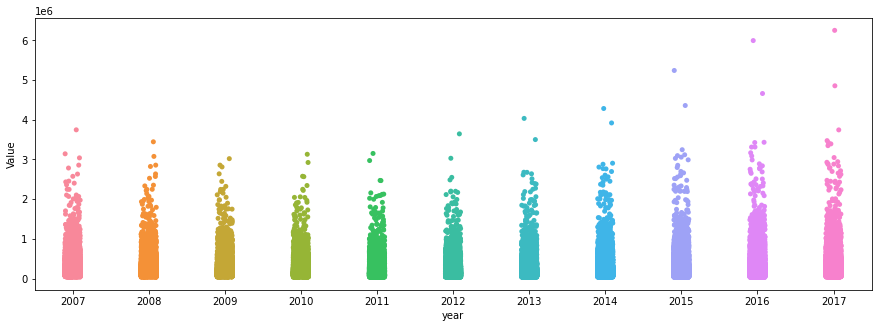

In [32]:
plt.figure(figsize=(15,5))
g=sns.stripplot (data=realestate_df2, x='year', y= 'Value')
#g.set_yscale(\"log\")\n",
#plt.xticks (rotation=90,fontsize= 12)#ha='right'\n",
None

In [33]:
#g= sns.FacetGrid(realestate_df2, col_wrap=3, col ='state', aspect=1.20, height=5)\n",
#g.map_dataframe (sns.stripplot, x='year', y= 'Value',hue='year')\n",
#g.add_legend()\n",
#g.set_yticklabels(fontsize= 8 )\n",
#g.set_yticklabels(fontsize= 8 )\n",
#g.set_titles(fontsize= 12 )"

## Mean Value per Zipcode

# Agrupacion por  state, y city  Valor promedio

In [34]:
realestate_df3 = rszhvi.groupby(['state','county','zipcode_clean'])['Value'].mean().sort_values(ascending=False).reset_index()
realestate_df3

,state,county,zipcode_clean,Value
0,CA,San Mateo,94027,4.078230e+06
1,CA,Los Angeles,90210,3.507410e+06
2,NY,Suffolk,11976,2.857306e+06
3,CA,San Diego,92067,2.735399e+06
4,CA,Los Angeles,90402,2.617714e+06
...,...,...,...,...
13195,PA,Cambria,15901,3.457619e+04
13196,OH,Mahoning,44510,3.157349e+04
13197,OH,Mahoning,44507,3.153373e+04
13198,OH,Mahoning,44502,3.116386e+04


## Mean Values per City

In [35]:
realestate_df4 = rszhvi.groupby(['city'])['Value'].mean().sort_values(ascending=False)[:].reset_index()
realestate_df4

,city,Value
0,Atherton,4.078230e+06
1,Water Mill,2.857306e+06
2,Portola Valley,2.466803e+06
3,Malibu,2.393843e+06
4,Rancho Santa Fe,2.368692e+06
...,...,...
6970,Washington Park,4.354286e+04
6971,River Rouge,4.347381e+04
6972,Ecorse,4.272381e+04
6973,North Braddock,4.268254e+04


In [36]:
#plt.figure(figsize=(12,10))
#realstate.groupby('city').size().sort_values(ascending=False)[:30].plot.barh()

In [37]:
rszhvi[['city','zipcode','Value']].groupby(['city', 'zipcode']).agg(['count'])

Value
                      count
city          zipcode      
Abbeville     31001     126
              38601     126
Aberdeen      21001     126
              28315     126
              39730     126
...                     ...
Zion          60099     126
Zionsville    46077     126
Zirconia      28790     126
Zolfo Springs 33890     126
Zumbro Falls  55991     126

[13200 rows x 1 columns]

In [38]:
rszhvi.zipcode.value_counts()

77503    126
34286    126
63080    126
76442    126
38023    126
        ... 
46767    126
60639    126
16033    126
3287     126
97753    126
Name: zipcode, Length: 13200, dtype: int64

In [39]:
rszhvi.zipcode.nunique()

13200

## Read listings csv

In [40]:
listings_df= pd.read_csv("data/listings.csv")
listings_df

,accommodates,amenities,availability_30,bathrooms,bed_type,bedrooms,beds,cancellation_policy,city,has_availability,...,review_scores_checkin,review_scores_cleanliness,review_scores_communication,review_scores_location,review_scores_rating,review_scores_value,room_type,state,weekly_price,zipcode
0,2.0,"{""Cable TV"",""Wireless Internet"",""Air condition...",24,1.0,Real Bed,1.0,1.0,moderate,sunnysidebronx,NaN,...,10.0,10.0,10.0,10.0,100.0,10.0,Private room,NY,NaN,10464
1,4.0,"{TV,Internet,""Wireless Internet"",""Air conditio...",30,1.0,Real Bed,1.0,1.0,flexible,sunnysidebronx,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,Private room,NY,NaN,10464
2,4.0,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",30,3.0,Real Bed,3.0,3.0,strict,sunnysidebronx,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,Entire home/apt,NY,NaN,10464
3,3.0,"{TV,Internet,""Wireless Internet"",""Air conditio...",8,1.0,Real Bed,1.0,1.0,strict,long island city,NaN,...,10.0,10.0,10.0,10.0,93.0,10.0,Entire home/apt,NY,775.0,10464
4,4.0,"{Internet,""Wireless Internet"",""Air conditionin...",17,1.0,Real Bed,1.0,1.0,moderate,sunnysidebronx,NaN,...,10.0,10.0,10.0,10.0,97.0,10.0,Private room,NY,350.0,10464
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
59819,2.0,"{Internet,""Wireless Internet"",""Air conditionin...",0,1.0,Real Bed,1.0,1.0,flexible,silver spring,NaN,...,9.0,8.0,9.0,8.0,80.0,9.0,Private room,MD,NaN,20910
59820,5.0,"{TV,""Cable TV"",""Wireless Internet"",""Air condit...",20,1.0,Real Bed,1.0,2.0,flexible,bethesda,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,Entire home/apt,MD,NaN,20816
59821,6.0,"{TV,Internet,""Wireless Internet"",""Air conditio...",13,1.0,Real Bed,1.0,3.0,strict,temple hills,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,Private room,MD,NaN,20748
59822,2.0,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",12,1.0,Real Bed,1.0,1.0,moderate,silver spring,NaN,...,10.0,9.0,10.0,10.0,100.0,10.0,Entire home/apt,MD,NaN,20910


## Clean zip code Listings

## Check zipcodes greater and less than 5 strings

In [41]:
#listings_df[listings_df['zipcode'].str.len()>5]
#listings_df[listings_df['zipcode'].str.len()<5]"

## Clean zip code Listings > 5 strings

In [42]:
listings_df['zipcode_clean'] = list(listings_df['zipcode'].str.slice(0,5))
listings_df.head()

,accommodates,amenities,availability_30,bathrooms,bed_type,bedrooms,beds,cancellation_policy,city,has_availability,...,review_scores_cleanliness,review_scores_communication,review_scores_location,review_scores_rating,review_scores_value,room_type,state,weekly_price,zipcode,zipcode_clean
0,2.0,"{""Cable TV"",""Wireless Internet"",""Air condition...",24,1.0,Real Bed,1.0,1.0,moderate,sunnysidebronx,NaN,...,10.0,10.0,10.0,100.0,10.0,Private room,NY,NaN,10464,10464
1,4.0,"{TV,Internet,""Wireless Internet"",""Air conditio...",30,1.0,Real Bed,1.0,1.0,flexible,sunnysidebronx,NaN,...,NaN,NaN,NaN,NaN,NaN,Private room,NY,NaN,10464,10464
2,4.0,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",30,3.0,Real Bed,3.0,3.0,strict,sunnysidebronx,NaN,...,NaN,NaN,NaN,NaN,NaN,Entire home/apt,NY,NaN,10464,10464
3,3.0,"{TV,Internet,""Wireless Internet"",""Air conditio...",8,1.0,Real Bed,1.0,1.0,strict,long island city,NaN,...,10.0,10.0,10.0,93.0,10.0,Entire home/apt,NY,775.0,10464,10464
4,4.0,"{Internet,""Wireless Internet"",""Air conditionin...",17,1.0,Real Bed,1.0,1.0,moderate,sunnysidebronx,NaN,...,10.0,10.0,10.0,97.0,10.0,Private room,NY,350.0,10464,10464


## Review Null Values for zipcode

In [43]:
print('null values: \n',)
print(listings_df.isna().sum(), '\n')
print('Total null values: ' ,listings_df.isna().sum().sum())

null values: 

accommodates                      61
amenities                          0
availability_30                    0
bathrooms                        202
bed_type                           0
bedrooms                          95
beds                             109
cancellation_policy                0
city                              46
has_availability               59824
host_id                            0
id                                 0
instant_bookable                   0
latitude                           0
longitude                          0
metropolitan                       0
name                              41
price                              0
property_type                      4
review_scores_checkin          14346
review_scores_cleanliness      14280
review_scores_communication    14285
review_scores_location         14349
review_scores_rating           14200
review_scores_value            14354
room_type                          0
state                  

## Checking zipcodes Null

In [44]:
df1 = listings_df[listings_df['zipcode'].isna()]
df1 = listings_df[listings_df['zipcode_clean'].isna()]


## Drop zipcode null from zipcode clean

## Drop zipcode null and > 5 strings  from zipcode clean

In [45]:
listings_df['zipcode_clean'].replace([' ','1m'],np.nan, inplace=True)
listings_df=listings_df.dropna(subset=['zipcode_clean'])
#listings_df
print(listings_df.isna().sum(), '\n')

accommodates                      61
amenities                          0
availability_30                    0
bathrooms                        198
bed_type                           0
bedrooms                          83
beds                              80
cancellation_policy                0
city                              40
has_availability               58995
host_id                            0
id                                 0
instant_bookable                   0
latitude                           0
longitude                          0
metropolitan                       0
name                              40
price                              0
property_type                      4
review_scores_checkin          14071
review_scores_cleanliness      14005
review_scores_communication    14009
review_scores_location         14073
review_scores_rating           13927
review_scores_value            14079
room_type                          0
state                              0
w

## Checking values space zipcode Listings

In [46]:
#listings_df[listings_df['zipcode']== ' ']

In [47]:
listings_df[listings_df['zipcode_clean'].str.len()<5]
listings_df[listings_df['zipcode_clean'].str.len()>5]

,accommodates,amenities,availability_30,bathrooms,bed_type,bedrooms,beds,cancellation_policy,city,has_availability,...,review_scores_cleanliness,review_scores_communication,review_scores_location,review_scores_rating,review_scores_value,room_type,state,weekly_price,zipcode,zipcode_clean


In [48]:
listings_df.shape

(58995, 30)

## Join Listings and Real Estate DFs by zipcode

In [51]:
listings_rs= listings_df.set_index('zipcode_clean').join(realestate_df3.set_index('zipcode_clean'), how='left',lsuffix = '_left', rsuffix = '_right')
listings_rs=listings_rs.reset_index()
listings_rs['zipcode']=listings_rs['zipcode'].str.slice(0,5)
listings_rs

,zipcode_clean,accommodates,amenities,availability_30,bathrooms,bed_type,bedrooms,beds,cancellation_policy,city,...,review_scores_location,review_scores_rating,review_scores_value,room_type,state_left,weekly_price,zipcode,state_right,county,Value
0,02108,3.0,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",7,1.0,Real Bed,1.0,1.0,strict,boston,...,10.0,88.0,9.0,Entire home/apt,MA,NaN,02108,MA,Suffolk,821225.396825
1,02108,6.0,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",12,1.0,Real Bed,2.0,4.0,strict,boston,...,10.0,86.0,9.0,Entire home/apt,MA,NaN,02108,MA,Suffolk,821225.396825
2,02108,2.0,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",0,NaN,Real Bed,1.0,NaN,strict,boston,...,10.0,91.0,9.0,Entire home/apt,MA,NaN,02108,MA,Suffolk,821225.396825
3,02108,3.0,"{""Cable TV"",Internet,""Wireless Internet"",""Air ...",0,1.0,Real Bed,1.0,1.0,strict,boston,...,10.0,93.0,9.0,Entire home/apt,MA,1300.0,02108,MA,Suffolk,821225.396825
4,02108,4.0,"{TV,Internet,""Wireless Internet"",""Air Conditio...",1,2.5,Real Bed,2.0,1.0,moderate,boston,...,10.0,100.0,9.0,Entire home/apt,MA,NaN,02108,MA,Suffolk,821225.396825
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
58990,80249,10.0,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",11,3.0,Real Bed,5.0,5.0,strict,denver,...,9.0,95.0,10.0,Entire home/apt,CO,NaN,80249,CO,Denver,192773.809524
58991,80249,8.0,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",11,3.0,Real Bed,3.0,3.0,moderate,denver,...,10.0,98.0,10.0,Entire home/apt,CO,1110.0,80249,CO,Denver,192773.809524
58992,80249,2.0,"{TV,Internet,""Wireless Internet"",""Air Conditio...",16,1.0,Real Bed,1.0,1.0,flexible,denver,...,10.0,100.0,10.0,Private room,CO,NaN,80249,CO,Denver,192773.809524
58993,80249,2.0,"{TV,Internet,""Wireless Internet"",Kitchen,""Free...",0,1.0,Real Bed,1.0,1.0,flexible,denver,...,10.0,98.0,10.0,Private room,CO,NaN,80249,CO,Denver,192773.809524


In [52]:
str(pd.DataFrame(listings_df['zipcode_clean']).merge(pd.DataFrame(realestate_df3['zipcode_clean']) ,how = 'left', on = 'zipcode_clean').shape)

'(58995, 1)'

## Check df by zipcode values

In [53]:
#listings_rs[listings_rs['index']== '80249']

## Limit listings df by property type

In [54]:
listings_filt = (listings_rs[listings_rs['property_type'].isin(['Apartment',
'House',
'Condominium',
'Townhouse',
'Loft',
'Bed & Breakfast'])])

listings_filt

,zipcode_clean,accommodates,amenities,availability_30,bathrooms,bed_type,bedrooms,beds,cancellation_policy,city,...,review_scores_location,review_scores_rating,review_scores_value,room_type,state_left,weekly_price,zipcode,state_right,county,Value
0,02108,3.0,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",7,1.0,Real Bed,1.0,1.0,strict,boston,...,10.0,88.0,9.0,Entire home/apt,MA,NaN,02108,MA,Suffolk,821225.396825
1,02108,6.0,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",12,1.0,Real Bed,2.0,4.0,strict,boston,...,10.0,86.0,9.0,Entire home/apt,MA,NaN,02108,MA,Suffolk,821225.396825
2,02108,2.0,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",0,NaN,Real Bed,1.0,NaN,strict,boston,...,10.0,91.0,9.0,Entire home/apt,MA,NaN,02108,MA,Suffolk,821225.396825
3,02108,3.0,"{""Cable TV"",Internet,""Wireless Internet"",""Air ...",0,1.0,Real Bed,1.0,1.0,strict,boston,...,10.0,93.0,9.0,Entire home/apt,MA,1300.0,02108,MA,Suffolk,821225.396825
4,02108,4.0,"{TV,Internet,""Wireless Internet"",""Air Conditio...",1,2.5,Real Bed,2.0,1.0,moderate,boston,...,10.0,100.0,9.0,Entire home/apt,MA,NaN,02108,MA,Suffolk,821225.396825
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
58990,80249,10.0,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",11,3.0,Real Bed,5.0,5.0,strict,denver,...,9.0,95.0,10.0,Entire home/apt,CO,NaN,80249,CO,Denver,192773.809524
58991,80249,8.0,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",11,3.0,Real Bed,3.0,3.0,moderate,denver,...,10.0,98.0,10.0,Entire home/apt,CO,1110.0,80249,CO,Denver,192773.809524
58992,80249,2.0,"{TV,Internet,""Wireless Internet"",""Air Conditio...",16,1.0,Real Bed,1.0,1.0,flexible,denver,...,10.0,100.0,10.0,Private room,CO,NaN,80249,CO,Denver,192773.809524
58993,80249,2.0,"{TV,Internet,""Wireless Internet"",Kitchen,""Free...",0,1.0,Real Bed,1.0,1.0,flexible,denver,...,10.0,98.0,10.0,Private room,CO,NaN,80249,CO,Denver,192773.809524


## Groupby of listings by price and value

In [55]:
pricevalue_df = listings_filt[['zipcode','city',"property_type",'price','Value']].groupby(['zipcode','city',"property_type"]).agg(['count', 'mean'])
pricevalue_df

price             Value               
                                 count        mean count           mean
zipcode city     property_type                                         
02108   boston   Apartment          65  220.169231    65  821225.396825
                 Bed & Breakfast     1  270.000000     1  821225.396825
                 Condominium         5  189.800000     5  821225.396825
                 House               1  690.000000     1  821225.396825
                 Townhouse           1  700.000000     1  821225.396825
...                                ...         ...   ...            ...
80247   denver   Apartment          16   28.937500    16  118458.730159
                 Condominium         2   77.500000     2  118458.730159
                 House               2   46.500000     2  118458.730159
80249   denver   House              27   82.740741    27  192773.809524
99135   new york Apartment           1  340.000000     0            NaN

[1605 rows x 4 columns]

## Check listings df by city

In [56]:
#listings_rs[listings_rs['city']== 'washington']